In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tqdm
from operator import itemgetter
import os
import time
import numba

In [3]:
def return_edges(img):
    
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    grad_x = cv2.Sobel(img_gray, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(img_gray, cv2.CV_64F, 0, 1, ksize=3)

    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)

    grad = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)
    grad = grad/255

    return grad

@numba.jit()
def energy_calculation(grad):
    m,n = grad.shape
    grad_copy = np.zeros_like(grad)
    grad_copy[-1,:] = grad[-1,:]

    for i in range(m-2,-1,-1):
        for j in range(n-1,-1,-1):

            min_val_list = []

            if (j-1) >= 0:
                min_val_list.append(grad_copy[i+1,j-1] + grad[i,j])
            if (j+1) <= (n-1):
                min_val_list.append(grad_copy[i+1,j+1] + grad[i,j])

            min_val_list.append(grad_copy[i+1,j] + grad[i,j])

            grad_copy[i,j] = np.min(np.array(min_val_list))
    return grad_copy

def removal_calculator(grad_copy):
    
    m,n = grad_copy.shape
    min_value = min(list(grad_copy[0,:]))
    pixels_list = []
    min_index = list(grad_copy[0,:]).index(min_value)
    pixels_list.append([0,min_index])

    for i in range(1,m):

        min_index_list = []

        if (min_index-1) >=0:
            min_index_list.append([grad_copy[i,min_index-1],-1])

        if (min_index+1) <= (n-1):
            min_index_list.append([grad_copy[i,min_index+1],1])

        min_index_list.append([grad_copy[i,min_index],0])
        min_index_list = sorted(min_index_list, key=itemgetter(0))   
        min_index = min_index + min_index_list[0][1]
        pixels_list.append([i,min_index])
        
    return pixels_list


def color_pink(img,pixels_list):
    for tup in pixels_list:
        img[tup[0],tup[1]] = [255, 192, 203]
    return img

def final_crop(img):
    
    m,n = img.shape[0], img.shape[1]
    img_reduced = np.zeros((m,n-1,3)).astype(np.uint8)
    counter_x = 0
    counter_y = 0
    for i in range(m):
        counter_y = 0
        for j in range(n):
            if (img[i,j,0]==255 and img[i,j,1]==192 and img[i,j,2]==203 ):
                continue
            else:
                img_reduced[counter_x,counter_y,:] = img[i,j,:]
                counter_y +=1

        counter_x += 1
    return img_reduced

def viz(img, img_reduced):
    plt.imshow(img)
    plt.show()
    plt.imshow(img_reduced)
    plt.show()

# Q1)A function, seam_carving

In [8]:
def seam_carving(image, number, is_vertical = True):
    
    img = np.copy(image)
    number_removals = number
    start_time = time.time()
    for i in range(number_removals):

        grad = return_edges(img)
        grad_copy = energy_calculation(grad)
        pixels_list = removal_calculator(grad_copy)
        img = color_pink(img,pixels_list)
        img_reduced = final_crop(img)
#         viz(img, img_reduced)
        img = img_reduced
    
    print("--- %s seconds ---" % (time.time() - start_time))
#     fig, axs = plt.subplots(1, 2,figsize=(16,8))
    
#     if is_vertical:
#         print("Original Dimensions: ", image.shape)
#         print("Seam Carved Dimensions: ", img.shape)
#         axs[0].imshow(image)
#         axs[0].set_title("Original Image")
#         axs[1].imshow(img)
#         axs[1].set_title("Seam Carved Image")
#         plt.show()
#     else:
#         print("Original Dimensions: ", cv2.transpose(image).shape)
#         print("Seam Carved Dimensions: ", cv2.transpose(img).shape)
#         axs[0].imshow(cv2.transpose(image))
#         axs[0].set_title("Original Image")
#         axs[1].imshow(cv2.transpose(img))
#         axs[1].set_title("Seam Carved Image")
#         plt.show()
    return img

# Vertical Seam-Carving

Image: 
 bangalore-dancers.jpg
The number of seams we are going to remove for percentage: 0.200000 is 100
--- 39.276904582977295 seconds ---
Original Dimensions:  (378, 504, 3)
Seam Carved Dimensions:  (378, 404, 3)


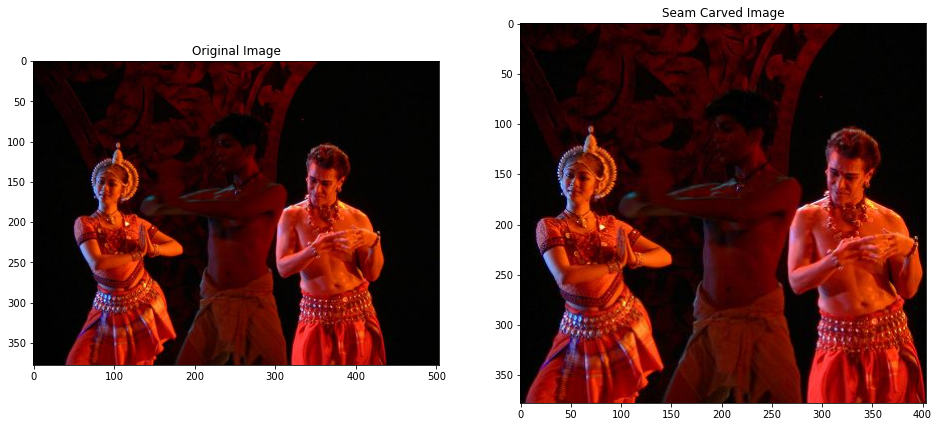

The number of seams we are going to remove for percentage: 0.400000 is 201
--- 69.09983348846436 seconds ---
Original Dimensions:  (378, 504, 3)
Seam Carved Dimensions:  (378, 303, 3)


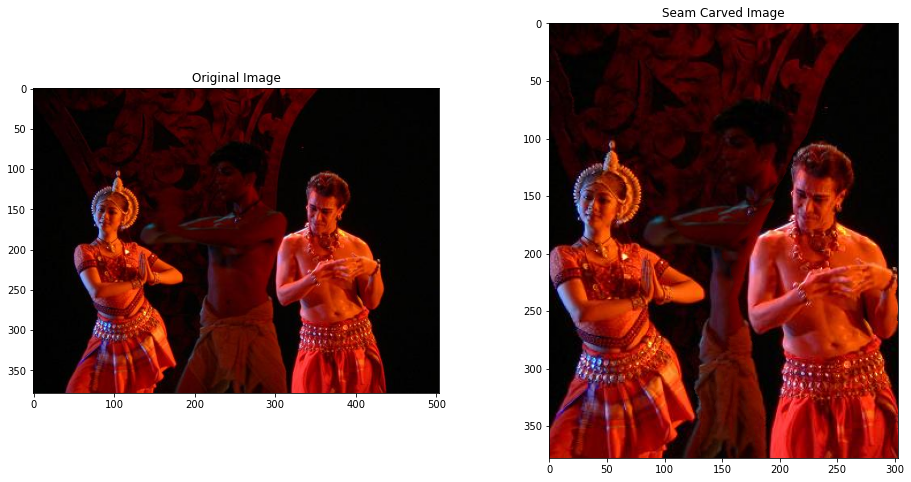

The number of seams we are going to remove for percentage: 0.600000 is 302
--- 90.7458815574646 seconds ---
Original Dimensions:  (378, 504, 3)
Seam Carved Dimensions:  (378, 202, 3)


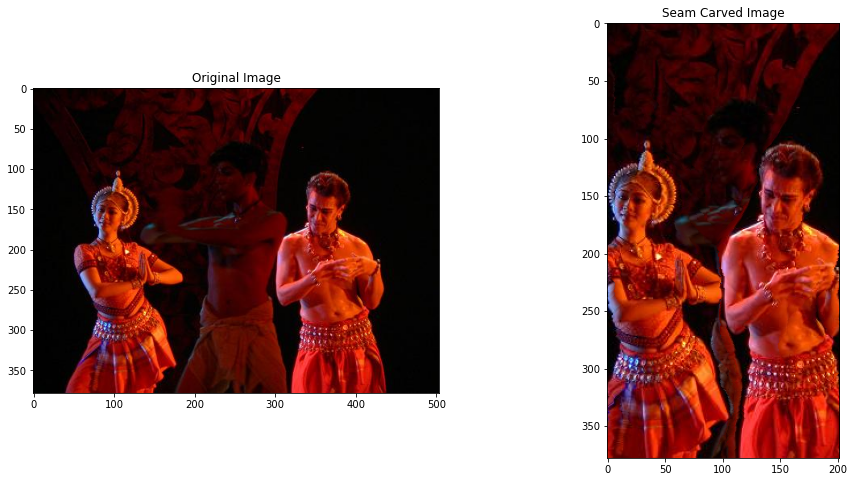

./images/bangalore-dancers.jpg
Image: 
 cat.jpg
The number of seams we are going to remove for percentage: 0.200000 is 30
--- 1.461226224899292 seconds ---
Original Dimensions:  (150, 150, 3)
Seam Carved Dimensions:  (150, 120, 3)


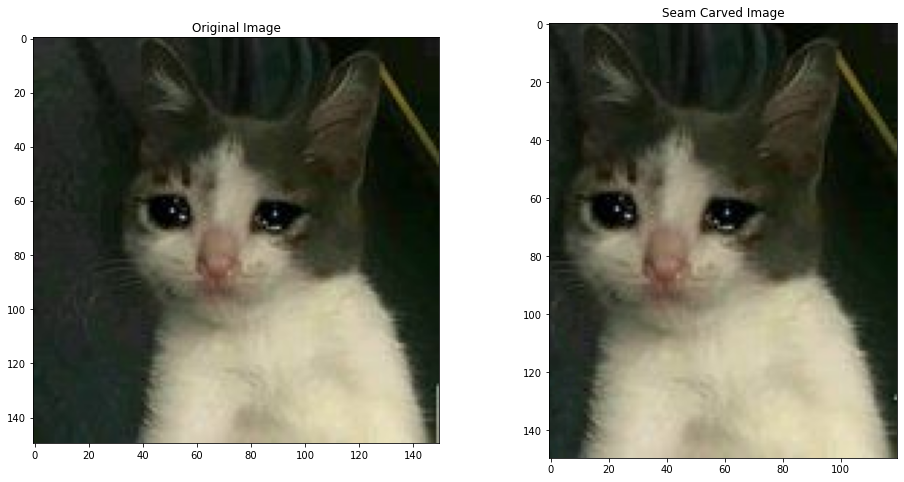

The number of seams we are going to remove for percentage: 0.400000 is 60
--- 2.489689826965332 seconds ---
Original Dimensions:  (150, 150, 3)
Seam Carved Dimensions:  (150, 90, 3)


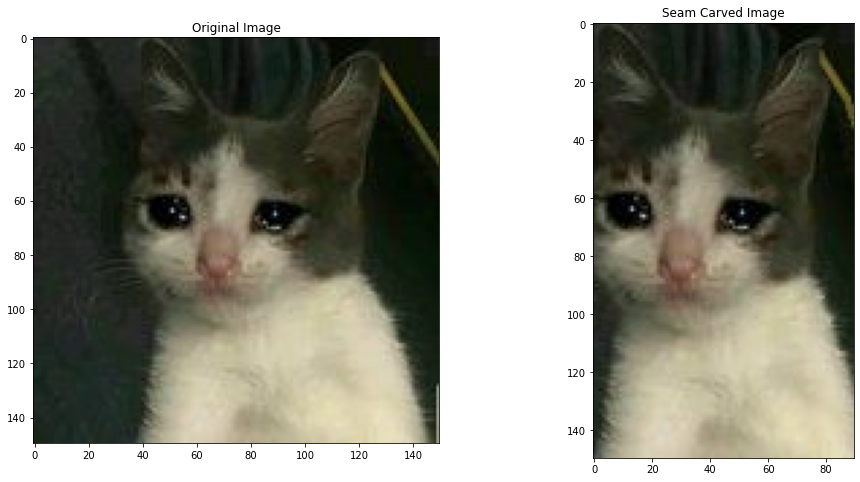

The number of seams we are going to remove for percentage: 0.600000 is 90
--- 3.2039031982421875 seconds ---
Original Dimensions:  (150, 150, 3)
Seam Carved Dimensions:  (150, 60, 3)


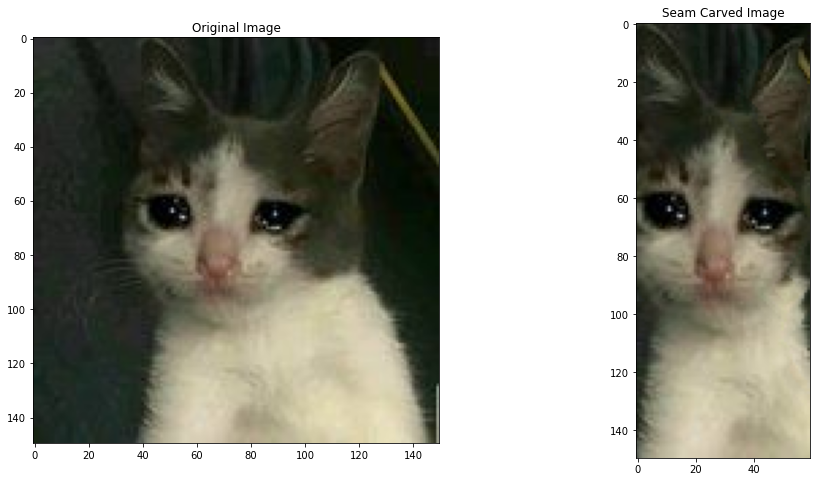

./images/cat.jpg
Image: 
 iiit.jpg
The number of seams we are going to remove for percentage: 0.200000 is 176
--- 115.2080249786377 seconds ---
Original Dimensions:  (369, 880, 3)
Seam Carved Dimensions:  (369, 704, 3)


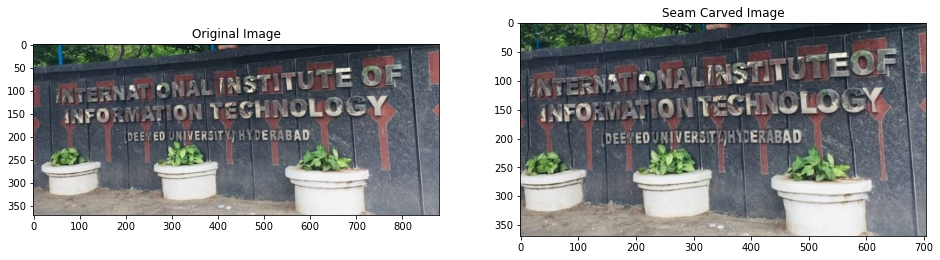

The number of seams we are going to remove for percentage: 0.400000 is 352
--- 203.33009910583496 seconds ---
Original Dimensions:  (369, 880, 3)
Seam Carved Dimensions:  (369, 528, 3)


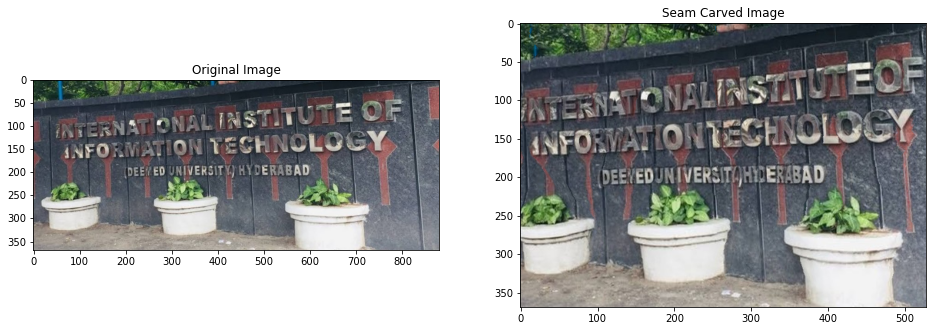

The number of seams we are going to remove for percentage: 0.600000 is 528
--- 267.712215423584 seconds ---
Original Dimensions:  (369, 880, 3)
Seam Carved Dimensions:  (369, 352, 3)


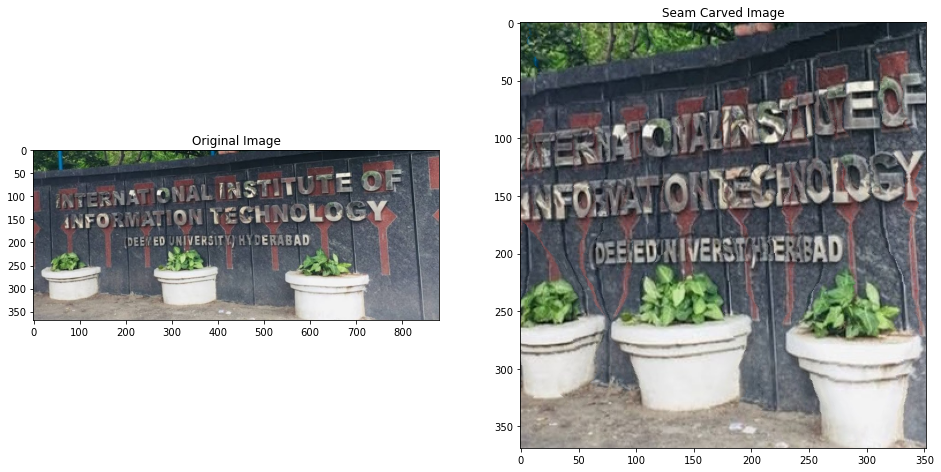

./images/iiit.jpg
Image: 
 shadow.jpg
The number of seams we are going to remove for percentage: 0.200000 is 100
--- 33.7920081615448 seconds ---
Original Dimensions:  (333, 500, 3)
Seam Carved Dimensions:  (333, 400, 3)


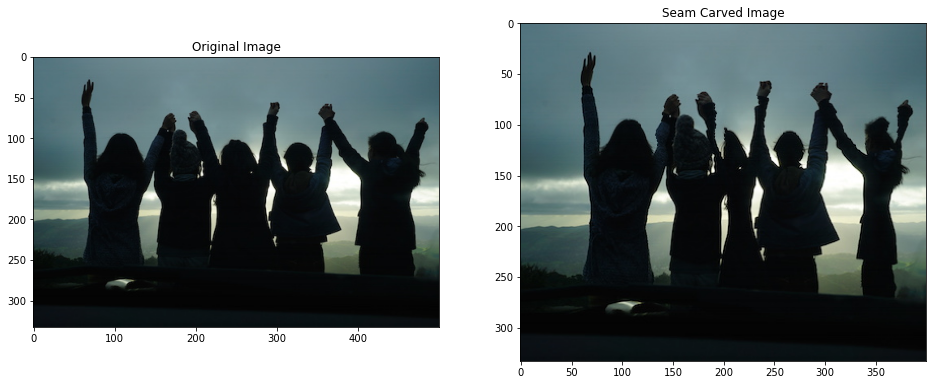

The number of seams we are going to remove for percentage: 0.400000 is 200
--- 59.613747119903564 seconds ---
Original Dimensions:  (333, 500, 3)
Seam Carved Dimensions:  (333, 300, 3)


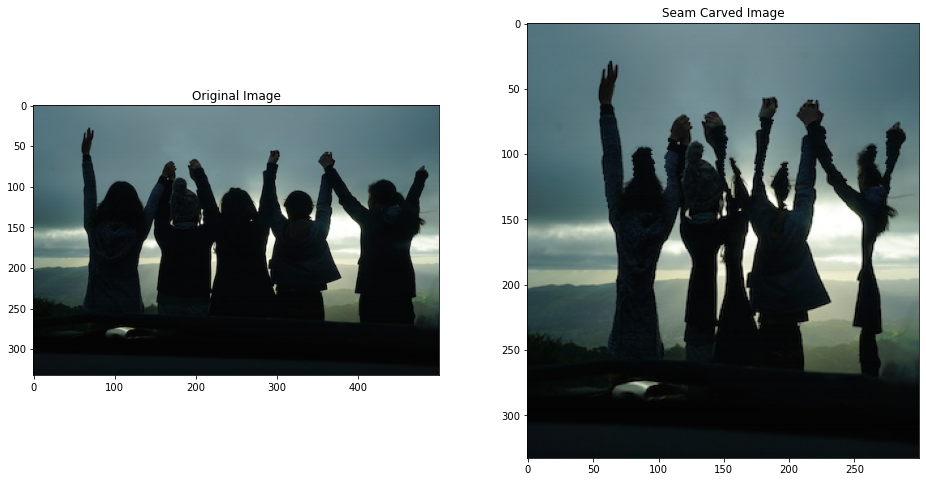

The number of seams we are going to remove for percentage: 0.600000 is 300
--- 77.88595914840698 seconds ---
Original Dimensions:  (333, 500, 3)
Seam Carved Dimensions:  (333, 200, 3)


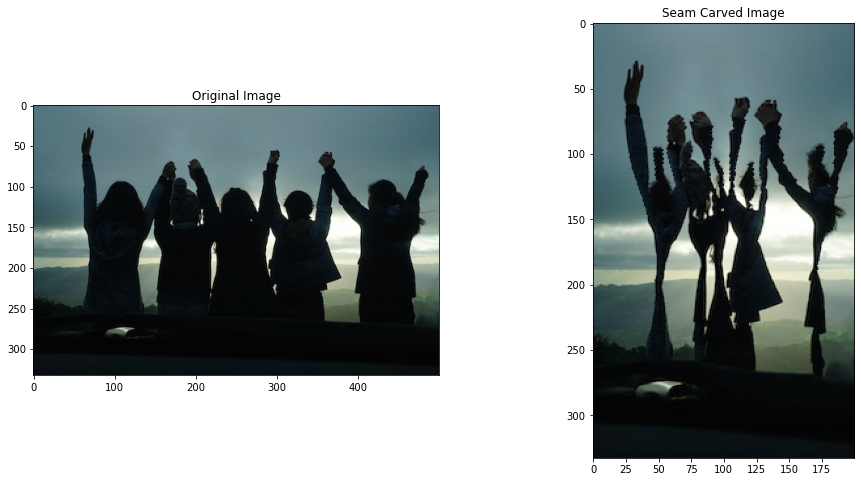

./images/shadow.jpg
Image: 
 tanjore.jpg
The number of seams we are going to remove for percentage: 0.200000 is 154
--- 119.25492858886719 seconds ---
Original Dimensions:  (500, 770, 3)
Seam Carved Dimensions:  (500, 616, 3)


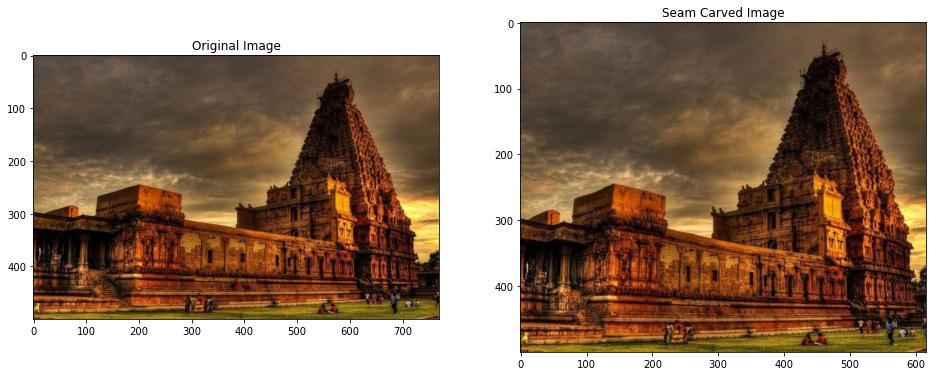

The number of seams we are going to remove for percentage: 0.400000 is 308
--- 213.00877022743225 seconds ---
Original Dimensions:  (500, 770, 3)
Seam Carved Dimensions:  (500, 462, 3)


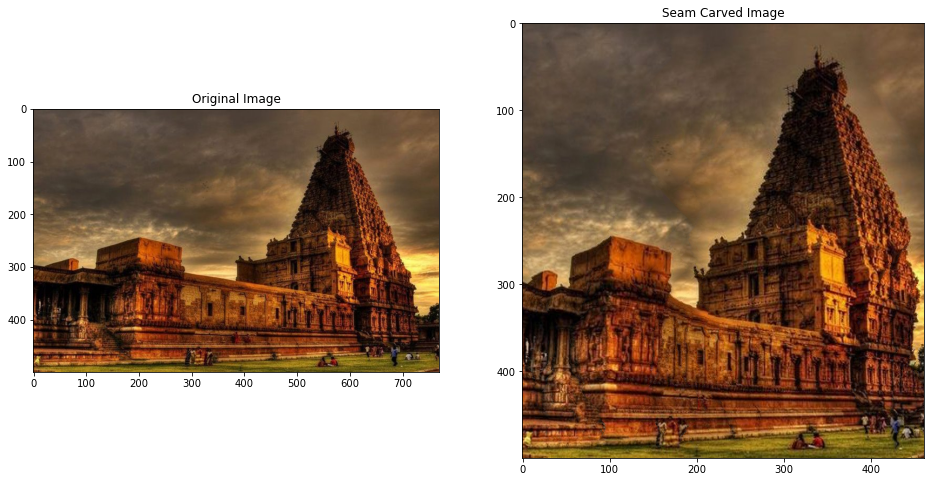

The number of seams we are going to remove for percentage: 0.600000 is 462
--- 277.6306564807892 seconds ---
Original Dimensions:  (500, 770, 3)
Seam Carved Dimensions:  (500, 308, 3)


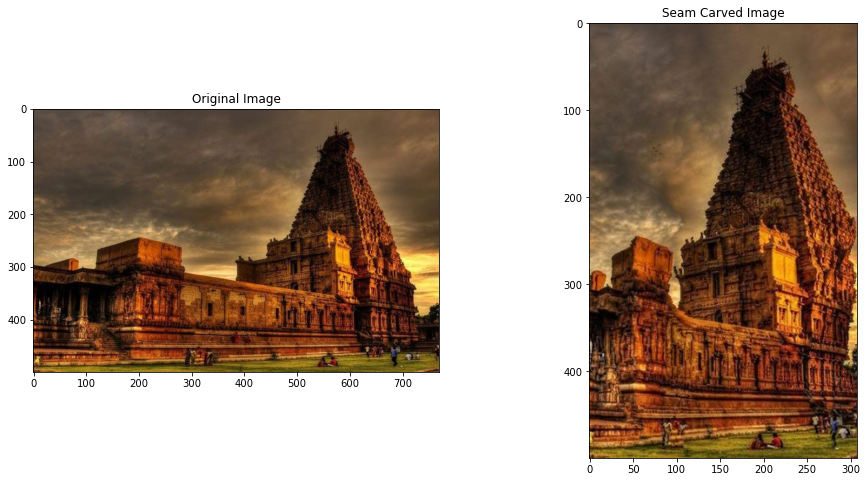

./images/tanjore.jpg
Image: 
 trafalgar-square.jpg
The number of seams we are going to remove for percentage: 0.200000 is 71
--- 16.65952730178833 seconds ---
Original Dimensions:  (319, 359, 3)
Seam Carved Dimensions:  (319, 288, 3)


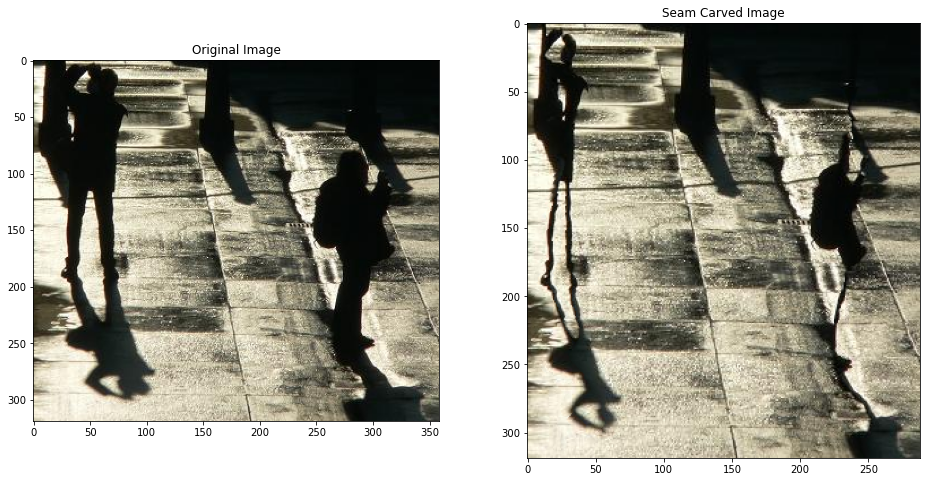

The number of seams we are going to remove for percentage: 0.400000 is 143
--- 29.768895864486694 seconds ---
Original Dimensions:  (319, 359, 3)
Seam Carved Dimensions:  (319, 216, 3)


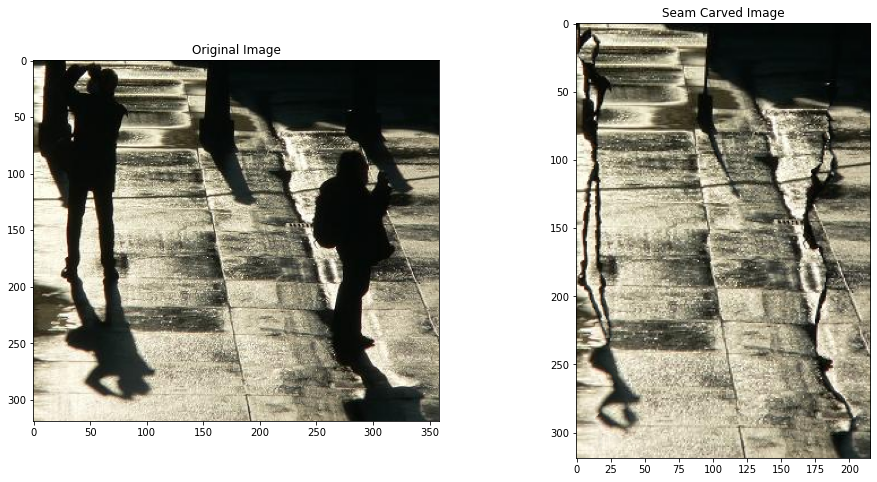

The number of seams we are going to remove for percentage: 0.600000 is 215
--- 39.27545785903931 seconds ---
Original Dimensions:  (319, 359, 3)
Seam Carved Dimensions:  (319, 144, 3)


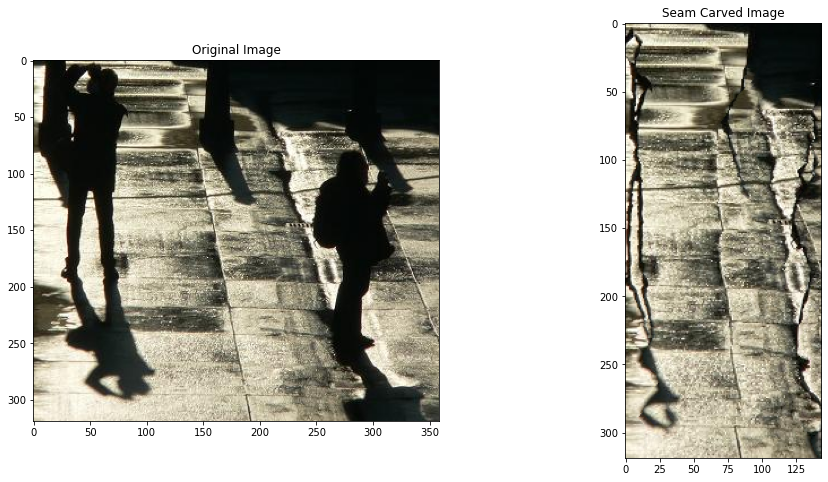

./images/trafalgar-square.jpg
Image: 
 uluru.jpg
The number of seams we are going to remove for percentage: 0.200000 is 100
--- 38.450610876083374 seconds ---
Original Dimensions:  (378, 504, 3)
Seam Carved Dimensions:  (378, 404, 3)


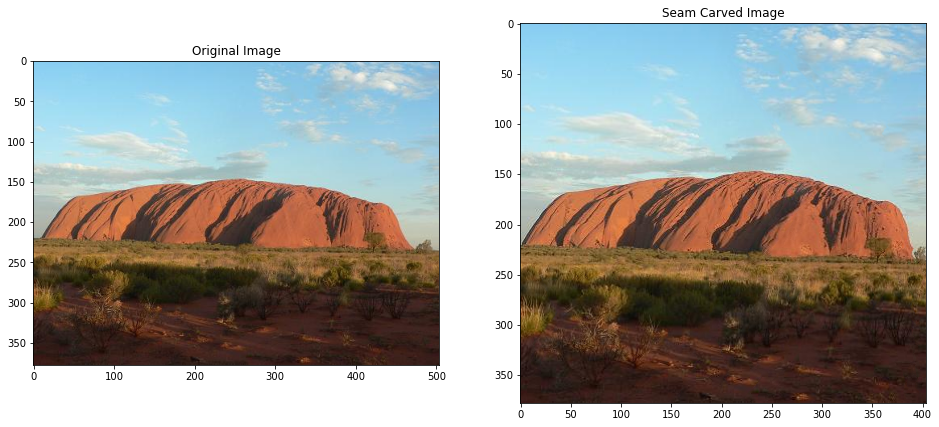

The number of seams we are going to remove for percentage: 0.400000 is 201
--- 68.32079839706421 seconds ---
Original Dimensions:  (378, 504, 3)
Seam Carved Dimensions:  (378, 303, 3)


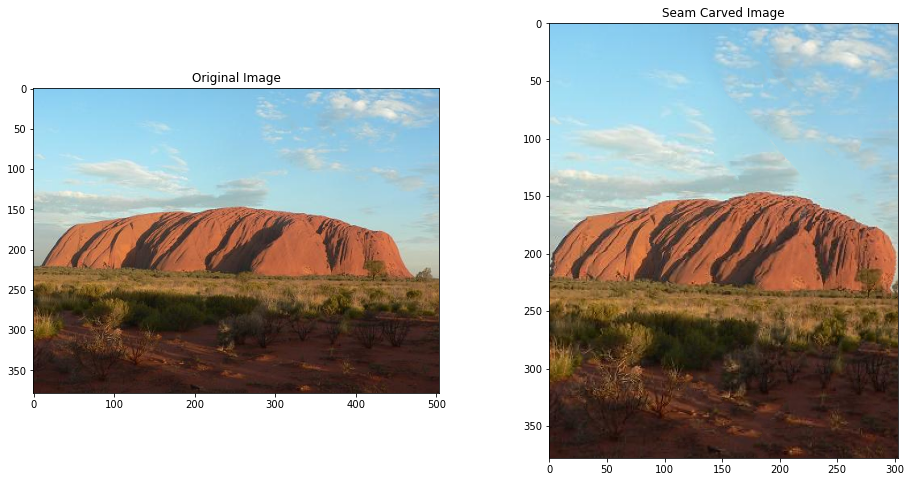

The number of seams we are going to remove for percentage: 0.600000 is 302
--- 89.76044249534607 seconds ---
Original Dimensions:  (378, 504, 3)
Seam Carved Dimensions:  (378, 202, 3)


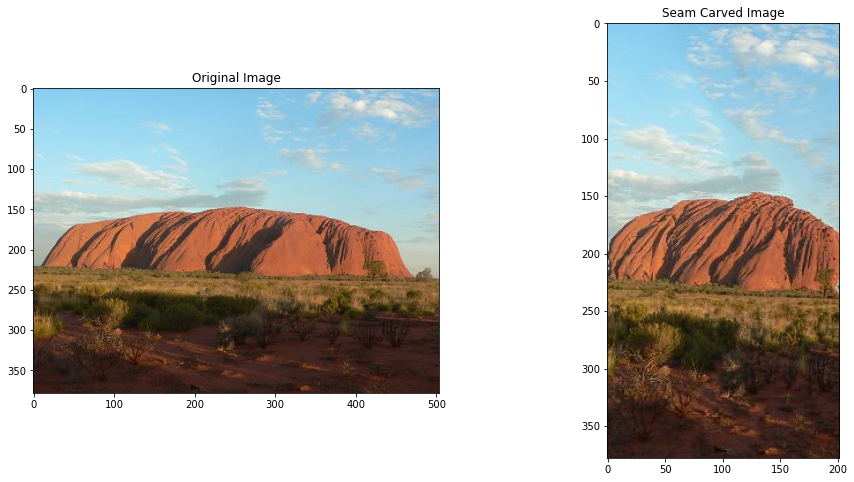

./images/uluru.jpg
Image: 
 chhota-bheem.jpg
The number of seams we are going to remove for percentage: 0.200000 is 384
--- 1878.7780408859253 seconds ---
Original Dimensions:  (1200, 1920, 3)
Seam Carved Dimensions:  (1200, 1536, 3)


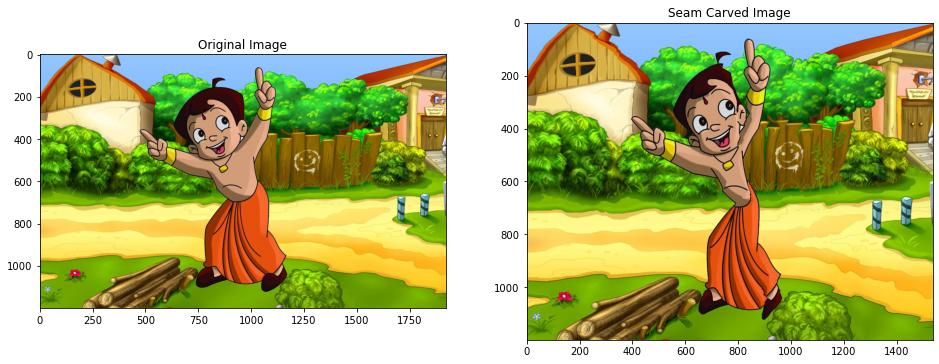

The number of seams we are going to remove for percentage: 0.400000 is 768
--- 3331.619374513626 seconds ---
Original Dimensions:  (1200, 1920, 3)
Seam Carved Dimensions:  (1200, 1152, 3)


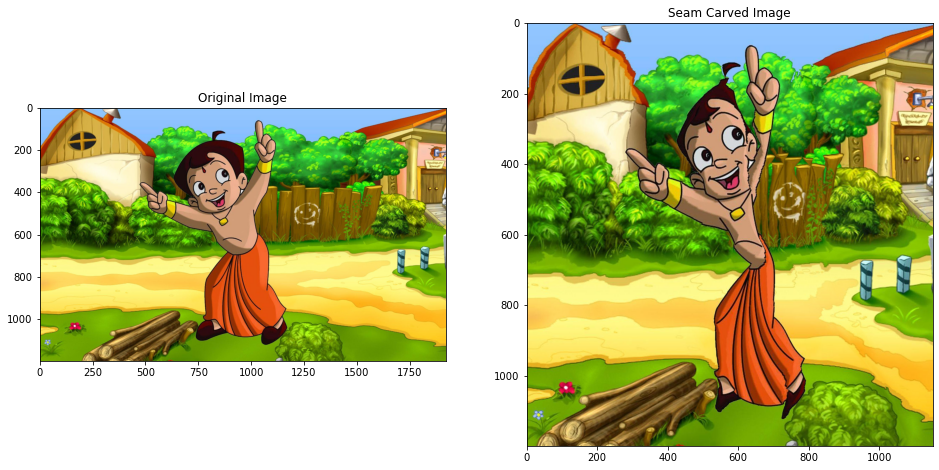

The number of seams we are going to remove for percentage: 0.600000 is 1152
--- 4361.149352073669 seconds ---
Original Dimensions:  (1200, 1920, 3)
Seam Carved Dimensions:  (1200, 768, 3)


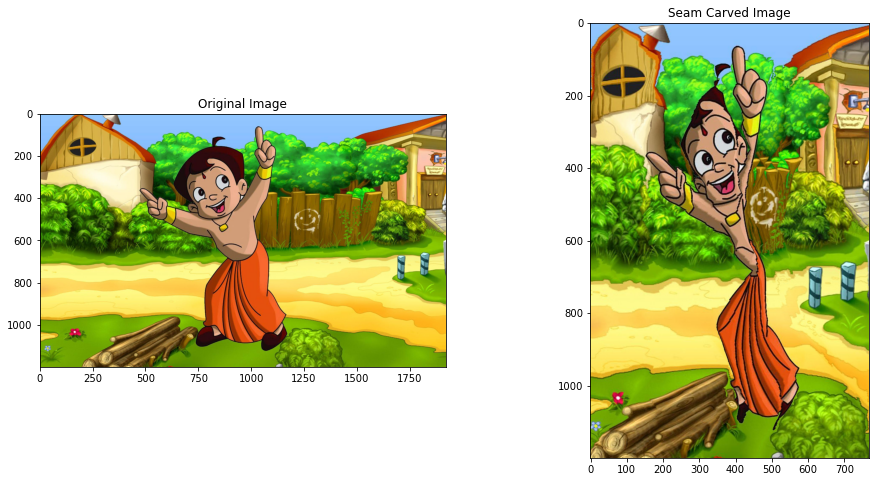

./images/chhota-bheem.jpg


In [4]:
root_dir = "../images"
img_list = ["bangalore-dancers.jpg","cat.jpg","iiit.jpg","shadow.jpg","tanjore.jpg","trafalgar-square.jpg","uluru.jpg","chhota-bheem.jpg"]
for filename in img_list:
    
    if filename != "path.jpg":
#     if filename == "cat.jpg":
        
        print("Image: \n", filename)
        img_path = os.path.join(root_dir,filename)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        for percentage in [0.2,0.4,0.6]:
            number = int(percentage*img.shape[1])
            print("The number of seams we are going to remove for percentage: %f is %d"%(percentage,number))
            seam_carving(img, number)
            
        print(img_path)

# Horizontal seam carving

Image: 
 path.jpg
The number of seams we are going to remove for percentage: 0.200000 is 100
--- 41.57856845855713 seconds ---
Original Dimensions:  (500, 375, 3)
Seam Carved Dimensions:  (400, 375, 3)


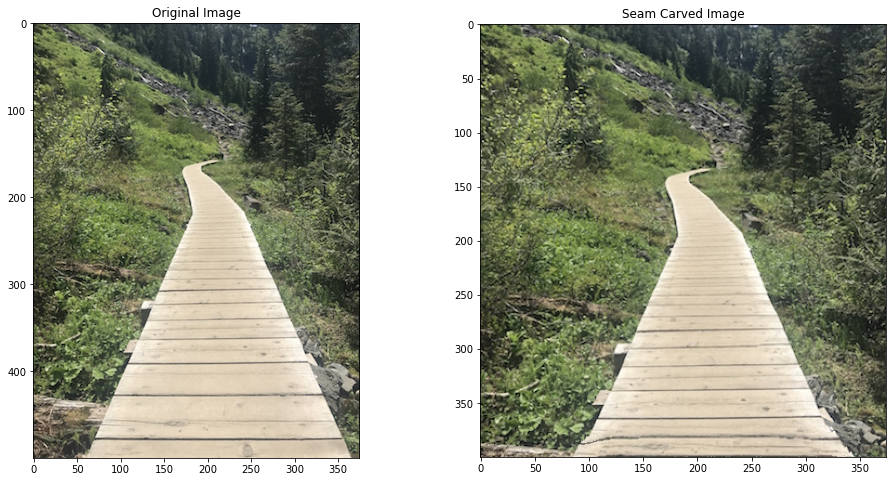

The number of seams we are going to remove for percentage: 0.400000 is 200
--- 72.05860710144043 seconds ---
Original Dimensions:  (500, 375, 3)
Seam Carved Dimensions:  (300, 375, 3)


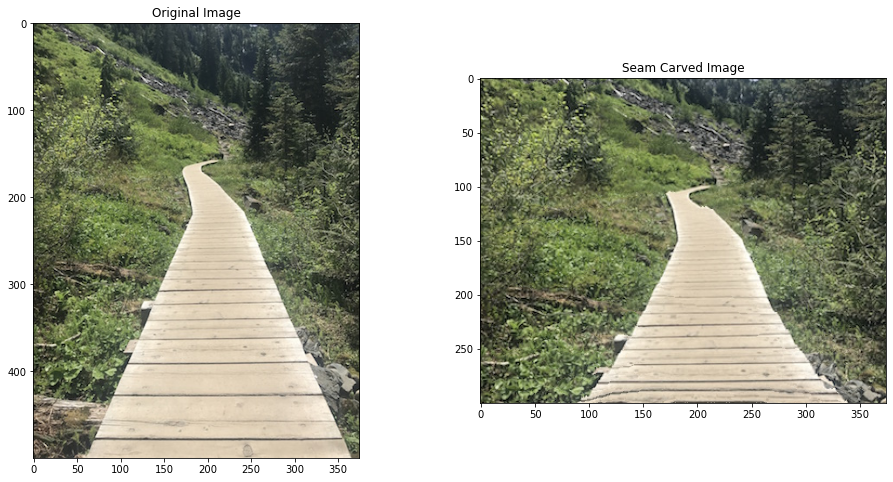

The number of seams we are going to remove for percentage: 0.600000 is 300
--- 94.22129416465759 seconds ---
Original Dimensions:  (500, 375, 3)
Seam Carved Dimensions:  (200, 375, 3)


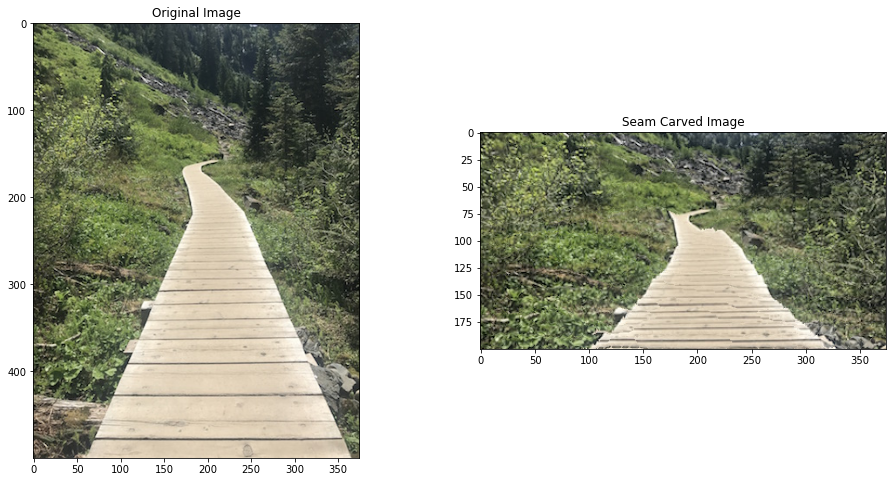

./images/path.jpg


In [12]:
root_dir = "../images"
img_list = ["path.jpg"]
for filename in img_list:
        
        print("Image: \n", filename)
        img_path = os.path.join(root_dir,filename)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img=cv2.transpose(img)
        for percentage in [0.2,0.4,0.6]:
            number = int(percentage*img.shape[1])
            print("The number of seams we are going to remove for percentage: %f is %d"%(percentage,number))
            seam_carving(img, number, False)
            
        print(img_path)

# Vertical seam carving on my face

Image: 
 me.jpeg
The number of seams we are going to remove for percentage: 0.200000 is 48
--- 16.775769233703613 seconds ---
Original Dimensions:  (320, 240, 3)
Seam Carved Dimensions:  (320, 192, 3)


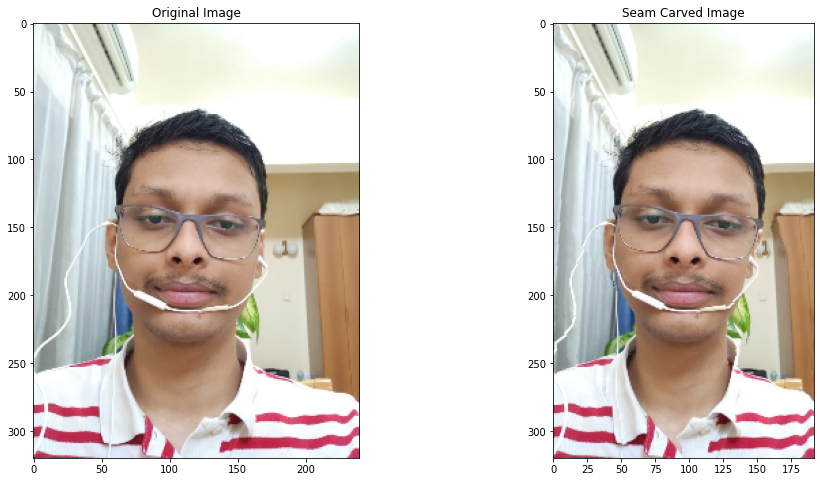

The number of seams we are going to remove for percentage: 0.400000 is 96
--- 31.65460181236267 seconds ---
Original Dimensions:  (320, 240, 3)
Seam Carved Dimensions:  (320, 144, 3)


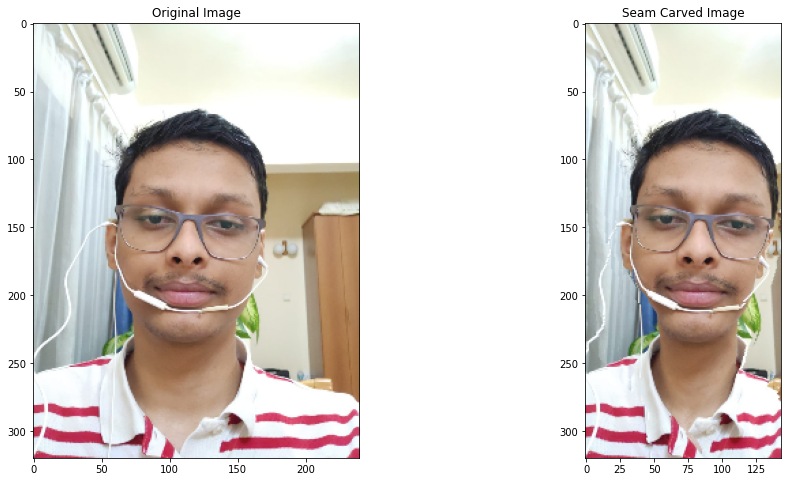

The number of seams we are going to remove for percentage: 0.600000 is 144
--- 39.846885681152344 seconds ---
Original Dimensions:  (320, 240, 3)
Seam Carved Dimensions:  (320, 96, 3)


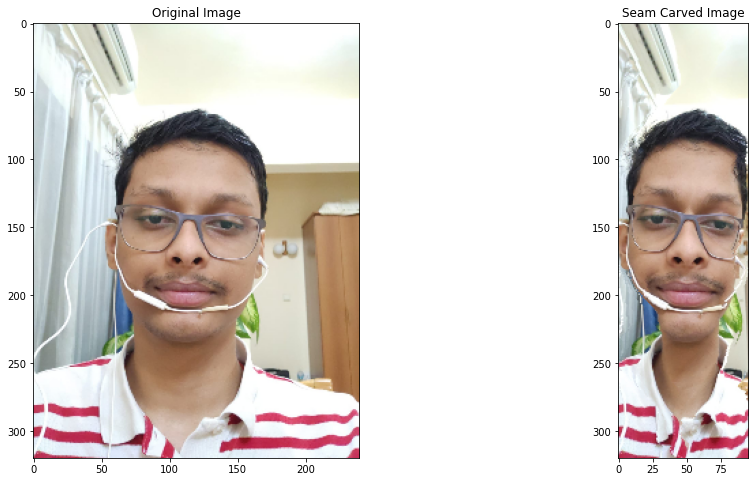

./images/me.jpeg


In [5]:
root_dir = "../images"
img_list = ["me.jpeg"]
for filename in img_list:
    
    if filename != "path.jpg":
#     if filename == "cat.jpg":
        
        print("Image: \n", filename)
        img_path = os.path.join(root_dir,filename)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (img.shape[1]//4,img.shape[0]//4))
        
        for percentage in [0.2,0.4,0.6]:
            number = int(percentage*img.shape[1])
            print("The number of seams we are going to remove for percentage: %f is %d"%(percentage,number))
            seam_carving(img, number)
            
        print(img_path)

# Horizontal seam carving on my face

Image: 
 me.jpeg
The number of seams we are going to remove for percentage: 0.200000 is 64
--- 24.33774471282959 seconds ---
Original Dimensions:  (320, 240, 3)
Seam Carved Dimensions:  (256, 240, 3)


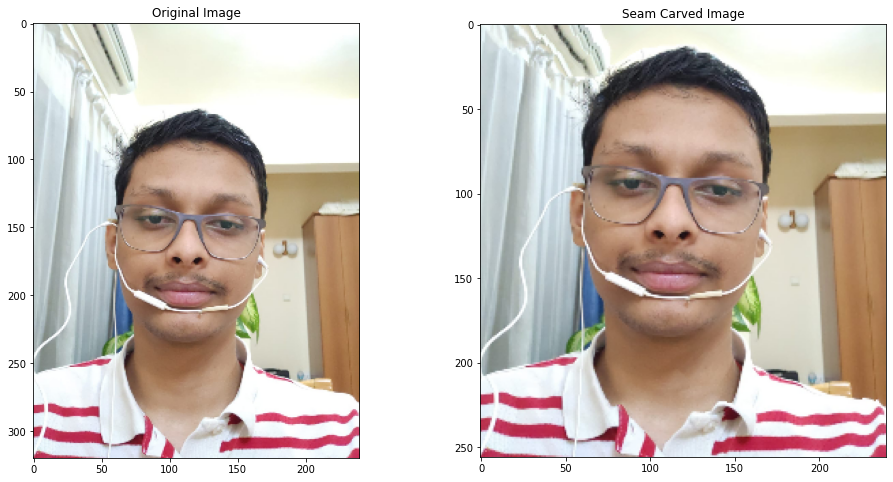

The number of seams we are going to remove for percentage: 0.400000 is 128
--- 41.33190870285034 seconds ---
Original Dimensions:  (320, 240, 3)
Seam Carved Dimensions:  (192, 240, 3)


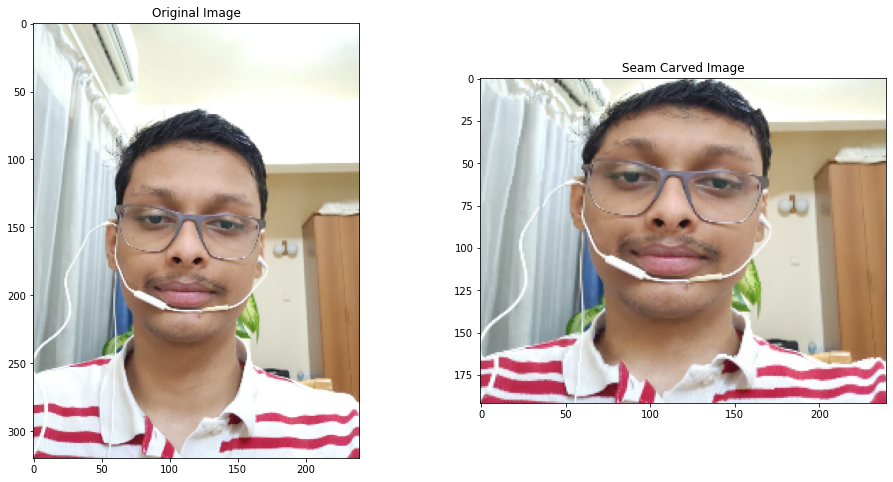

The number of seams we are going to remove for percentage: 0.600000 is 192
--- 51.787665605545044 seconds ---
Original Dimensions:  (320, 240, 3)
Seam Carved Dimensions:  (128, 240, 3)


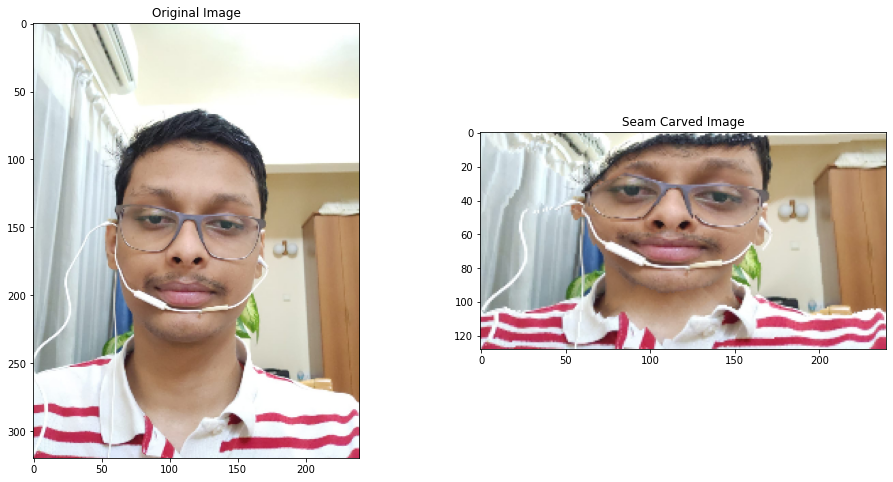

./images/me.jpeg


In [6]:
root_dir = "./images"
img_list = ["me.jpeg"]
for filename in img_list:
        
        print("Image: \n", filename)
        img_path = os.path.join(root_dir,filename)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (img.shape[1]//4,img.shape[0]//4))
        img=cv2.transpose(img)
        for percentage in [0.2,0.4,0.6]:
            number = int(percentage*img.shape[1])
            print("The number of seams we are going to remove for percentage: %f is %d"%(percentage,number))
            seam_carving(img, number, False)
            
        print(img_path)

# Q1)B

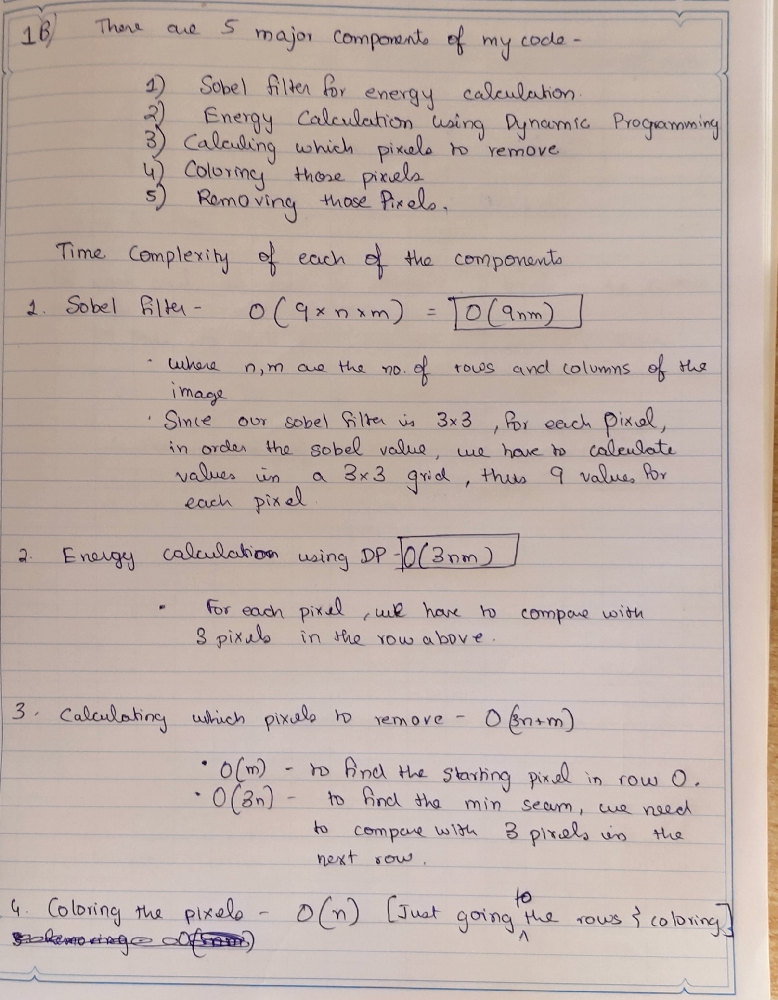

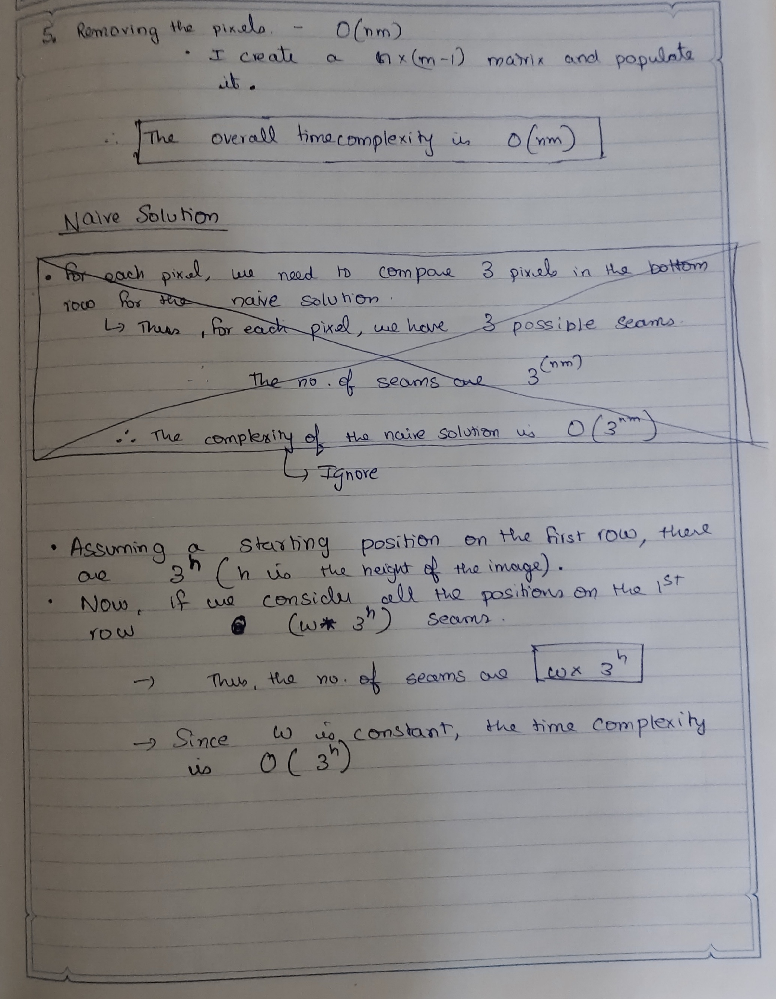

# Q1)C)a
## Here, I will study the effect of flipping the image upside down using my face

Image: 
 me.jpeg
The number of seams we are going to remove for percentage: 0.200000 is 48
--- 13.617198705673218 seconds ---
--- 13.871602773666382 seconds ---
Are the two images exactly the same?
False


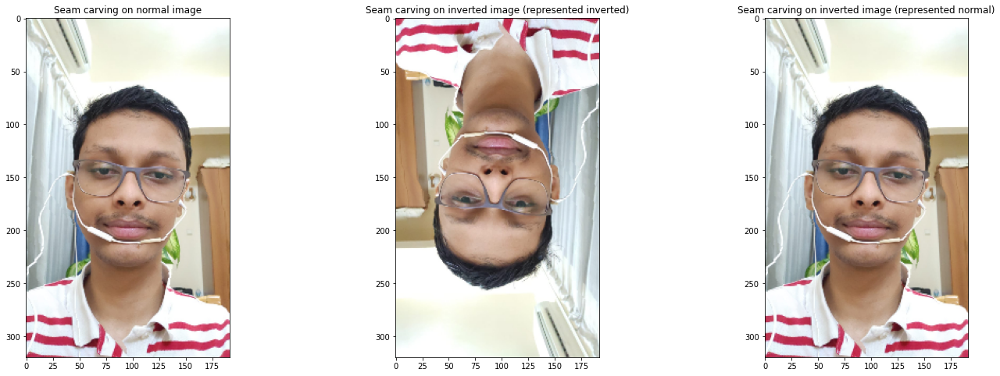

In [20]:
root_dir = "../images"
img_list = ["me.jpeg"]
for filename in img_list:
    
    if filename != "path.jpg":
#     if filename == "cat.jpg":
        
        print("Image: \n", filename)
        img_path = os.path.join(root_dir,filename)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (img.shape[1]//4,img.shape[0]//4))
        
        percentage = 0.2
        number = int(percentage*img.shape[1])
        print("The number of seams we are going to remove for percentage: %f is %d"%(percentage,number))
        img_normal = seam_carving(img, number)
        img = cv2.rotate(img, cv2.ROTATE_180)
        img_down = seam_carving(img, number)

        fig, axs = plt.subplots(1, 3,figsize=(24,8))
    
        axs[0].imshow(img_normal)
        axs[0].set_title("Seam carving on normal image")
        axs[1].imshow(img_down)
        axs[1].set_title("Seam carving on inverted image (represented inverted)")
        axs[2].imshow(cv2.rotate(img_down, cv2.ROTATE_180))
        axs[2].set_title("Seam carving on inverted image (represented normal)")

        print("Are the two images exactly the same?")
        print(np.array_equal(img_normal, cv2.rotate(img_down, cv2.ROTATE_180)))

        plt.show()

1. Will the result be the same if the image is flipped upside down? 

- Thus, we can see that when we carry out seam carving on the original image and the flipped image, we get visually similiar results.
- However, the images are not numerically exactly the same, the difference in pixel values is upto 1-2.
- Thus, the result is not exactly the same.
- This change in results is not due to changes in the energy map, but rather changes due to chance. Tehe minimum seam remains the same, but the seam that is chosen may change as many such minimum seams may exist.

2. What happens to the overall energy in the image during seam carving?

- Since we remove slices of an image during seam carving, the number of pixels in the image reduce, and hence the energy of the image also reduces

# Q1)C)b
## Here, I will study the effect of seam carving in different directions

# First case

Image: 
 vertical.jpg
--- 29.648507595062256 seconds ---
--- 12.106762886047363 seconds ---


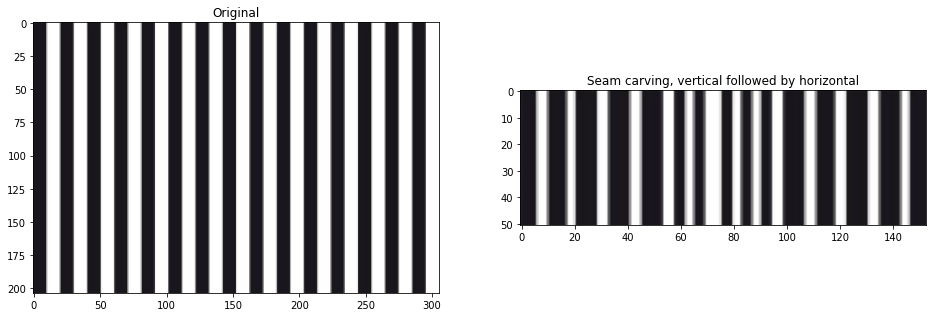

--- 25.921048879623413 seconds ---
--- 7.614760398864746 seconds ---


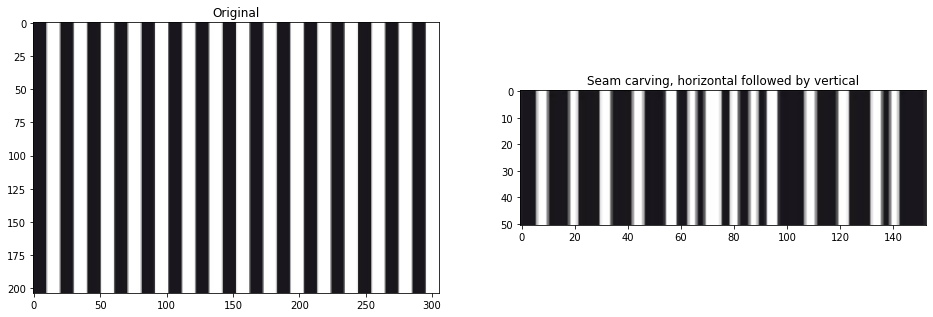

Are the two outputs for the two strategies exactly the same?
False


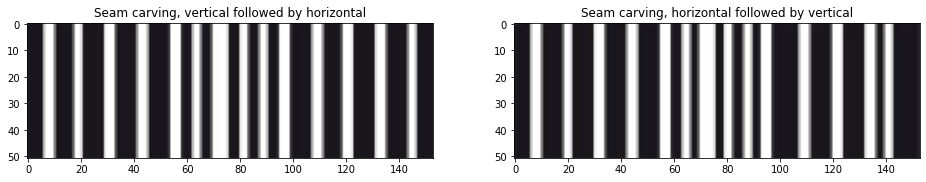

In [30]:
root_dir = "../images"
img_list = ["vertical.jpg"]
for filename in img_list:
    
        
        print("Image: \n", filename)
        img_path = os.path.join(root_dir,filename)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (img.shape[1]//2,img.shape[0]//2))
        
        percentage = 0.5
        number = int(percentage*img.shape[1])
        
        # First vertical seam carving, followed by horizontal
        img_sc_vertical = seam_carving(img, number)
        img_sc_vertical_horizonal = seam_carving(cv2.transpose(img_sc_vertical), number)
        img_sc_vertical_horizonal = cv2.transpose(img_sc_vertical_horizonal)

        fig, axs = plt.subplots(1, 2,figsize=(16,8))
    
        axs[0].imshow(img)
        axs[0].set_title("Original")
        axs[1].imshow(img_sc_vertical_horizonal)
        axs[1].set_title("Seam carving, vertical followed by horizontal")
        
        plt.show()
        
        # First Horizontal seam carving, followed by Vertical
        img_sc_horizontal = seam_carving(cv2.transpose(img), number)
        img_sc_horizontal = cv2.transpose(img_sc_horizontal)
        img_sc_horizontal_vertical = seam_carving(img_sc_horizontal, number)

        fig, axs = plt.subplots(1, 2,figsize=(16,8))
    
        axs[0].imshow(img)
        axs[0].set_title("Original")
        axs[1].imshow(img_sc_horizontal_vertical)
        axs[1].set_title("Seam carving, horizontal followed by vertical")
        
        plt.show()
        
        fig, axs = plt.subplots(1, 2,figsize=(16,8))
    
        axs[0].imshow(img_sc_vertical_horizonal)
        axs[0].set_title("Seam carving, vertical followed by horizontal")
        axs[1].imshow(img_sc_horizontal_vertical)
        axs[1].set_title("Seam carving, horizontal followed by vertical")


        print("Are the two outputs for the two strategies exactly the same?")
        print(np.array_equal(img_sc_vertical_horizonal, img_sc_horizontal_vertical))

        plt.show()

# Second case

Image: 
 horizontal.png
--- 2.5117852687835693 seconds ---
--- 1.2517881393432617 seconds ---


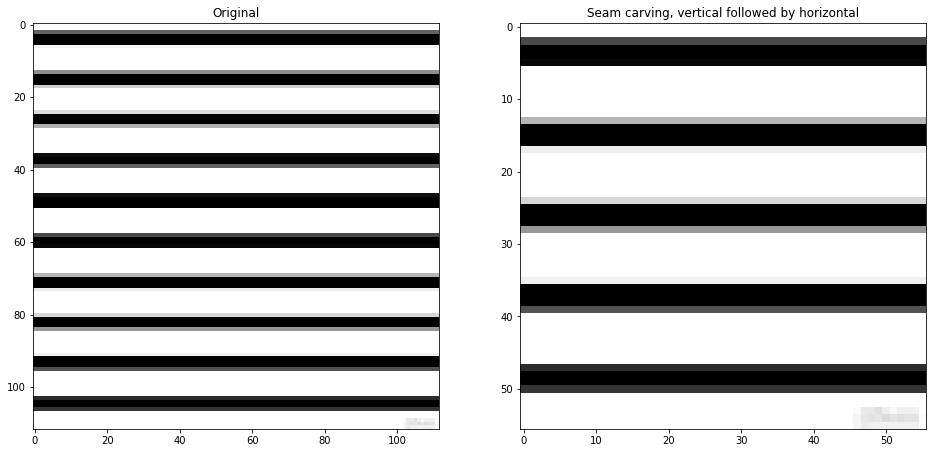

--- 2.6885719299316406 seconds ---
--- 1.3040013313293457 seconds ---


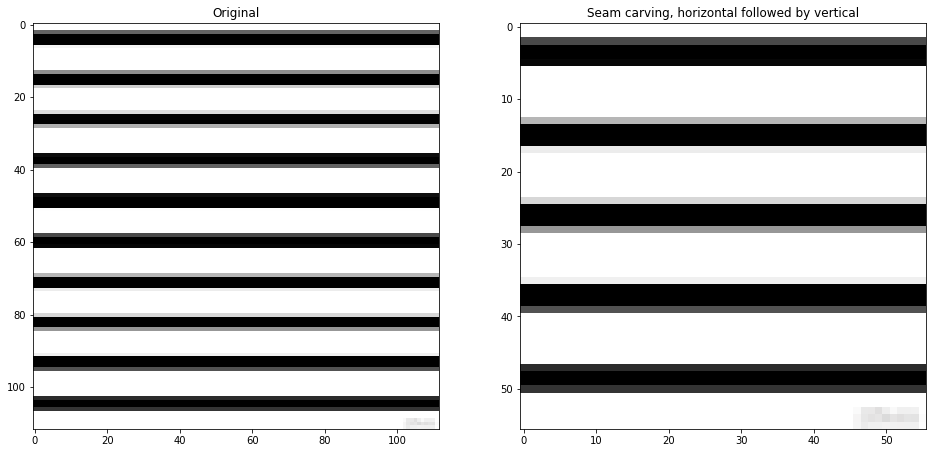

Are the two outputs for the two strategies exactly the same?
True


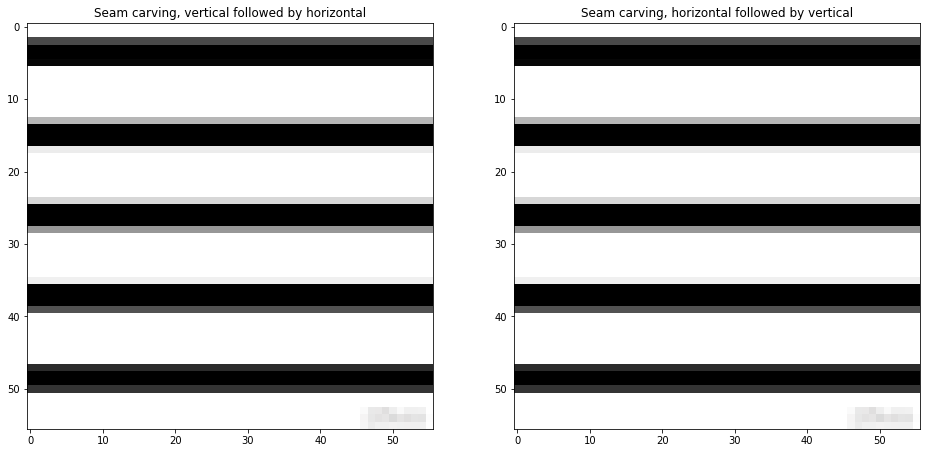

In [33]:
root_dir = "../images"
img_list = ["horizontal.png"]
for filename in img_list:
    
        
        print("Image: \n", filename)
        img_path = os.path.join(root_dir,filename)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (img.shape[1]//2,img.shape[0]//2))
        
        percentage = 0.5
        number = int(percentage*img.shape[1])
        # First vertical seam carving, followed by horizontal
        img_sc_vertical = seam_carving(img, number)
        img_sc_vertical_horizonal = seam_carving(cv2.transpose(img_sc_vertical), number)
        img_sc_vertical_horizonal = cv2.transpose(img_sc_vertical_horizonal)

        fig, axs = plt.subplots(1, 2,figsize=(16,8))
    
        axs[0].imshow(img)
        axs[0].set_title("Original")
        axs[1].imshow(img_sc_vertical_horizonal)
        axs[1].set_title("Seam carving, vertical followed by horizontal")
        
        plt.show()
        
        # First Horizontal seam carving, followed by Vertical
        img_sc_horizontal = seam_carving(cv2.transpose(img), number)
        img_sc_horizontal = cv2.transpose(img_sc_horizontal)
        img_sc_horizontal_vertical = seam_carving(img_sc_horizontal, number)

        fig, axs = plt.subplots(1, 2,figsize=(16,8))
    
        axs[0].imshow(img)
        axs[0].set_title("Original")
        axs[1].imshow(img_sc_horizontal_vertical)
        axs[1].set_title("Seam carving, horizontal followed by vertical")
        
        plt.show()
        
        fig, axs = plt.subplots(1, 2,figsize=(16,8))
    
        axs[0].imshow(img_sc_vertical_horizonal)
        axs[0].set_title("Seam carving, vertical followed by horizontal")
        axs[1].imshow(img_sc_horizontal_vertical)
        axs[1].set_title("Seam carving, horizontal followed by vertical")


        print("Are the two outputs for the two strategies exactly the same?")
        print(np.array_equal(img_sc_vertical_horizonal, img_sc_horizontal_vertical))

        plt.show()

# Observations and answers

1. Whether we want to go ahead with vertical seam carving followed by horizontal seam carving; or horizontal seam carving followed by vertical seam carving does have an effect on the output numerically. The outputs are not **exactly** the same for the first case, but are **exactly** the same for the second case.

2. However, visually, are mostly the same. We cannot see any perceivable difference between the two methods.

3. In the first case, we can see the black lines are thicker when we do vertical followed by horizontal, but no such difference can be found in the second case. 

### Thus, perhaps there is no optimal order of seam carving. It depends on the image being used. Sometimes one method will perform better than the other, in other cases, both the methods will perform equally.

- However, it is to be noted that continuous seam removal in one direction leads to distortion of the image (this phenomenon can be seen throughout the notebook). Thus, it will be better to alternate between vertical seam carving and horizontal seam carving to preserve the features of the image further.